* adapted from https://learnopencv.com/custom-object-detection-training-using-yolov5/

## Introduction
The field of deep learning started taking off in 2012. Around that time, it was a bit of an exclusive field. We got to see that the people writing deep learning programs and software were either deep learning practitioners, researchers with extensive experience in the field, or people with really good coding skills. 

Today, only after 10 years or so, the scene has changed drastically, and for the better. Literally, a student who has been learning deep learning for only a few weeks can train a neural network model within 20 lines of code. And not just off-the-shelf training on benchmark datasets. We are talking about training on custom datasets with some of the best models out there. Not believing it? Well, this is exactly what we are going to do in this post with Custom Object Detection Training using YOLOV5.

We will cover the following points in this blog post:

- We will train YOLOv5s (small) and YOLOv5m (medium) models on a custom dataset.
- We will also check how freezing some of the layers of a model can lead to faster iteration time per epoch and what impacts it can have on the final result.
- Along with that, we will compare the performance of the models which include the mAP, FPS, and the inference time on CPU and GPU.

### What is YOLOv5?

If you are in the field of machine learning and deep learning for some time now, there is a very high chance that you have already heard about YOLO. YOLO is short for You Only Look Once. It is a family of single-stage deep learning based object detectors. They are capable of more than real-time object detection with state-of-the-art accuracy.

Officially, as part of the Darknet framework, there are four versions of YOLO. Starting from YOLOv1 to YOLOv4. The Darknet framework is written in C and CUDA.

**YOLOv5 is the next version equivalent in the YOLO family with a few exceptions.**

- The project was started by Glenn Jocher under the [Ultralytics organization on GitHub](https://github.com/ultralytics).
- It was written using Python language and the framework used is PyTorch.
- It is in itself a collection of object detection models. Starting from very small models, capable of giving real-time FPS on edge devices to very large and accurate models meant for cloud GPU deployments. It has almost everything one might need.

<div> <img src="images/fig61.png" alt="Drawing" style="width: 500px;"/></div> 

It has a host of other features and capabilities which make it the choice of go-to object detection model/repository when anybody even thinks of object detection today. We will check those out shortly.

### Models Available in YOLOv5

To begin exploring the entire landscape of YOLOv5, let’s start with the models. It contains 5 models in total. Starting from YOLOv5 nano (smallest and fastest) to YOLOv5 extra-large (the largest model).

The following is a short description of each of these:

- [YOLOv5n](https://github.com/ultralytics/yolov5/blob/master/models/yolov5n.yaml): It is a newly introduced nano model, which is the smallest in the family and meant for the edge, IoT devices, and with OpenCV DNN support as well. It is less than 2.5 MB in INT8 format and around 4 MB in FP32 format. It is ideal for mobile solutions. 

- [YOLOv5s](https://github.com/ultralytics/yolov5/blob/master/models/yolov5s.yaml): It is the small model in the family with around 7.2 million parameters and is ideal for running inference on the CPU.

- [YOLOv5m](https://github.com/ultralytics/yolov5/blob/master/models/yolov5m.yaml): This is the medium-sized model with 21.2 million parameters. It is perhaps the best suited model for a lot of datasets and training as it provides a good balance between speed and accuracy.

- [YOLOv5l](https://github.com/ultralytics/yolov5/blob/master/models/yolov5l.yaml): It is the large model of the YOLOv5 family with 46.5 million parameters. It is ideal for datasets where we need to detect smaller objects.

- [YOLOv5x](https://github.com/ultralytics/yolov5/blob/master/models/yolov5x.yaml): It is the largest among the five models and has the highest mAP among the 5 as well. Although it is slower compared to the others and has 86.7 million parameters.

The following figure shows an even better overview of all the models including the inference speed on CPU, GPU, and also the number of parameters with an image size of 640.

<div> <img src="images/fig62.png" alt="Drawing" style="width: 500px;"/></div> 

All the model checkpoints are available for download from the [repository](https://github.com/ultralytics/yolov5). They have all been pretrained on the MS COCO dataset for 300 epochs.

## Features Provided by the YOLOv5 Repository and Codebase

If you go through the repository, it becomes pretty evident that it makes training and inference on custom datasets extremely easy. So much so that it is safe to say, if you already have a dataset ready in the correct format, you can get started with training within 2 minutes.

But training and inference are not all. It contains a lot of other features which make it really special. Let’s go over them:

### A Number of Models to Choose From
We have already discussed above that we can choose from 5 different models depending on our use case and dataset. Whether it is training a real-time detector for the edge or deploying a state-of-the-art object detection model on cloud GPUs, it has everything one might need.

### Numerous Export Options

Only training and inference of models are not enough for an object detection pipeline to be complete. In real-life use cases, deployment is also a major requirement. Before deployment, we mostly need to convert (export) the trained model to the correct format.

<div> <img src="images/fig63.png" alt="Drawing" style="width: 500px;"/></div> 


We can convert the native PyTorch (.pt) models to formats like:

- TorchScript
- ONNX
- OpenVINO
- TensorRT
- CoreML
- TensorFlow SavedModel, GraphDef, Lite, Edge TPU, and TensorFlow.js as well

This opens a myriad of deployment options for any deep learning engineer.

### Logging

YOLOv5 repository provides TensorBoard and Weights&Biases logging by default. Although you may need to create a Weights&Biases account and provide the API credentials before you can start the training for proper logging.

Even if you skip that, TensorBoard logs are already present containing every metric, loss, and images along with all the validation predictions. This makes it easier for us to take a look at the performance metrics at any point after training a model.

### Genetic Algorithm for Anchor Box Selection

While many object detection models use predefined anchor boxes according to the MS COCO dataset, YOLOv5 takes a different approach. In fact, the previous versions of YOLO, like YOLOv2 used only k-Means clustering for that.

But YOLOv5 uses a genetic algorithm to generate the anchor boxes. They call this process **autoanchor**, which recomputes the anchor boxes to fit the data if the default ones are not good. This is used in conjunction with the k-Means algorithm to create **k-Means evolved anchor boxes**. This is one of the reasons why YOLOv5 works so well even on varied datasets.

### Mosaic Augmentation

Another reason for such good training and detection results of the YOLOv5 model is [mosaic augmentation](https://arxiv.org/pdf/2004.10934.pdf).

<div> <img src="images/fig64.png" alt="Drawing" style="width: 500px;"/></div> 

In simple words, it is combining 4 different images into one so that the model can learn to deal with varied and difficult images. It uses other augmentation techniques also along with mosaic augmentation. 

## Comparison Between YOLOv5 and YOLOv3

Now that we have seen the different models available in YOLOv5 and what are the different features the codebase provides, let’s compare YOLOv5 with the previous YOLOv3 models. These comparisons mostly focus on the mAP of the models with 608×608 image dimensions and include both Darknet and Ultralytics models.

<div> <img src="images/fig65.png" alt="Drawing" style="width: 500px;"/></div> 

It is clear that the Ultralytics YOLOv3-SPP model was able to beat the Darknet YOLOv3 SPP model in terms of mAP. And the Ultralytics YOLOv5 models perform even better. The YOLOv5m, which is roughly a 21 million parameter model, is able to beat the YOLOv3-SPP model which is a 63 million parameter model. This shows how much the Ultralytics models have improved over the years.

Note: In the above figure, you may find that some of the Darknet YOLOv3 results are slightly better compared to the original paper. The reason is that, as the Darknet YOLOv3 models were updated, the mAP numbers were updated by Ultralytics in their repository as well. This also allows us to have a fair comparison among all the last updated models.

## Custom Object Detection Training using YOLOv5

For custom object detection training using YOLOv5, we will use the [Vehicle-OpenImages](https://public.roboflow.com/object-detection/vehicles-openimages) dataset from Roboflow.

The dataset contains images of various vehicles in varied traffic conditions. These images have been collected from the [Open Image dataset](https://storage.googleapis.com/openimages/web/index.html). The images are from varied conditions and scenes. It contains 5 classes in total. They are Car, Bus, Motorcycle, Truck, Ambulance. 

The dataset contains images of 5 different types of vehicles in varied conditions. Such a dataset with these classes can make for a good real-time traffic monitoring application. Although we are not going to do that in this post, we will be completing the first step required in such a process. That is, building a good object detector. And with YOLOv5, it is going to be really easy as the dataset is already in the required format.

The dataset contains 439 images for training, 125 images for validation, and 63 images for testing. But we will only use the training and validation sets in this post. Before moving forward, here are a few images with the ground truth boxes drawn on them.

<div> <img src="images/fig66.png" alt="Drawing" style="width: 500px;"/></div> 


### Approach for Custom Training
Let’s check out what we will cover during the custom training using YOLOv5.

- We will start with training the small YOLOv5 model.
- Then we will train a medium model and check the improvement as compared to the small model.
- Next, we will freeze a few layers of the medium model and train the model again. 
- We will carry out inference in all the above cases and also compare the mAP metrics along with the FPS during inference on videos.

## Custom Training Code

Here, we will go through all the necessary and important coding parts. These include:

- The dataset preparation.
- Training of the three models as discussed above.
- Performance comparison.
- Inference on images and videos.

Let’s go over all the important parts of the code starting with importing the modules and libraries that we use in the notebook.

In [1]:
# We will need glob for capturing file paths in a directory, matplotlib for visualization, and cv2 for reading images.

import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

## Hyperparameters and Constants

Here, we define whether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [2]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 25

## Download and Prepare the Dataset

We will use the <a href="https://public.roboflow.com/object-detection/vehicles-openimages" target="_blank">Vehicles-OpenImages</a> dataset for training the custom YOLOv5 object detector.

Let's download the dataset.

In [3]:
if not os.path.exists('train'):
    !curl -L "https://public.roboflow.com/ds/xKLV14HbTF?key=aJzo7msVta" > roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   893  100   893    0     0   1667      0 --:--:-- --:--:-- --:--:--  1669

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  2 38.4M    2  860k    0     0   520k      0  0:01:15  0:00:01  0:01:14  971k
 12 38.4M   12 4860k    0     0  1815k      0  0:00:21  0:00:02  0:00:19 2544k
 25 38.4M   25 9872k    0     0  2701k      0  0:00:14  0:00:03  0:00:11 3418k
 39 38.4M   39 15.0M    0     0  3319k      0  0:00:11  0:00:04  0:00:07 3974k
 50 38.4M   50 19.5M    0     0  3541k      0  0:00:11  0:00:05  0:00:06 4096k
 60 38.4M   60 23.3M    0     0  3586k      0  0:00:10  0:00:06  0:00:04 4600k
 71 38.4M   71 27.2M    0     0  3649k      0  0:00:10  0:00:07  0:00:03 4633k
 84 38.4M   84 32.4M    0     0  3827k      0  0:0

In [4]:
# extract to a folder
import zipfile
with zipfile.ZipFile("roboflow.zip","r") as zip_ref:
    zip_ref.extractall("roboflow_vehicles")

In [5]:
# remove the zipped file
import os

zipped_file = r'roboflow.zip'
os.remove(zipped_file)

In [6]:
dirs = ['roboflow_vehicles/train', 'roboflow_vehicles/valid', 'roboflow_vehicles/test']

for i, dir_name in enumerate(dirs):
    all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
    for j, image_name in enumerate(all_image_names):
        if (j % 2) == 0:
            file_name = image_name.split('.jpg')[0]
            os.remove(f"{dir_name}/images/{image_name}")
            os.remove(f"{dir_name}/labels/{file_name}.txt")

The original data had two instances of each image and label file. The rest of the code in the above block deletes the duplicate image and it's corresponding text file containing the label.

The dataset is structured in the following manner:

```
├── data.yaml
├── README.dataset.txt
├── README.roboflow.txt
├── test
│   ├── images
│   └── labels
├── train
│   ├── images
│   └── labels
└── valid
    ├── images
    └── labels

```

## Helper Functions to Download Files

The following function is for downloading any file in the notebook. In further sections of the notebook, we will use it for downloading the inference data.

In [7]:
def download_file(url, save_name):
    url = url
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)
    else: 
        print('File already present, skipping download...')

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 5 classes: **'Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck'**.

The following block shows the contents of the `data.yaml` file.

```yaml
train: ../train/images
val: ../valid/images

nc: 5
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
```

### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images. 

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [8]:
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [9]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [10]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [11]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

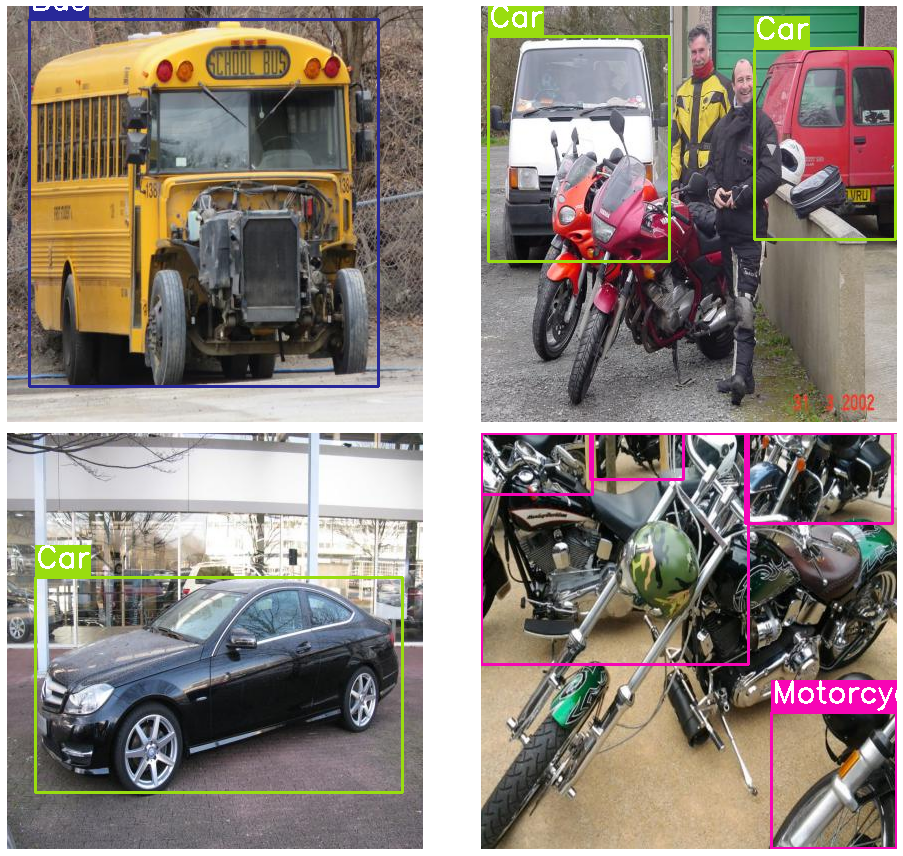

In [12]:
# Visualize a few training images.
plot(
    image_paths='roboflow_vehicles/train/images/*', 
    label_paths='roboflow_vehicles/train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [13]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [33]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [15]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

In [16]:
%cd yolov5/
!pwd

D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5


'pwd' is not recognized as an internal or external command,
operable program or batch file.


In [17]:
!pip install -r requirements.txt

  Using cached thop-0.1.0.post2207010342-py3-none-any.whl (15 kB)


## Training using YOLOV5

The next step is to train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

will be starting with training all the layers of the small model. This means that, although the pretrained weights will be loaded, the entire model will be fine-tuned on the new dataset.

And frankly, even with controlling all the arguments it is just one simple command as shown below.

In [25]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../roboflow_vehicles/data.yaml --weights yolov5s.pt --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} --workers 0

Current number of result directories: 7
results_8


train: weights=yolov5s.pt, cfg=, data=../roboflow_vehicles/data.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=0, project=runs\train, name=results_8, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github:  YOLOv5 is out of date by 14 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
fatal: cannot change to 'D:\IIUM_PC\4.': No such file or directory
YOLOv5  2022-7-7 Python-3.7.9 torch-1.7.1 CUDA:0 (NVIDIA GeForce RTX 2060, 6144MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmu

      1/24     4.53G   0.07605   0.03303   0.03518        37       640:  68%|######7   | 19/28 [00:13<00:05,  1.50it/s]
      1/24     4.53G   0.07605   0.03303   0.03518        37       640:  71%|#######1  | 20/28 [00:13<00:05,  1.53it/s]
      1/24     4.53G   0.07566    0.0328   0.03476        49       640:  71%|#######1  | 20/28 [00:13<00:05,  1.53it/s]
      1/24     4.53G   0.07566    0.0328   0.03476        49       640:  75%|#######5  | 21/28 [00:13<00:04,  1.53it/s]
      1/24     4.53G   0.07571   0.03274   0.03446        65       640:  75%|#######5  | 21/28 [00:14<00:04,  1.53it/s]
      1/24     4.53G   0.07571   0.03274   0.03446        65       640:  79%|#######8  | 22/28 [00:14<00:03,  1.54it/s]
      1/24     4.53G   0.07576   0.03257   0.03432        59       640:  79%|#######8  | 22/28 [00:15<00:03,  1.54it/s]
      1/24     4.53G   0.07576   0.03257   0.03432        59       640:  82%|########2 | 23/28 [00:15<00:03,  1.53it/s]
      1/24     4.53G   0.07544   0.03242

      6/24     4.53G   0.05059   0.02824   0.02176        56       640:  32%|###2      | 9/28 [00:06<00:12,  1.54it/s]
      6/24     4.53G   0.05059   0.02824   0.02176        56       640:  36%|###5      | 10/28 [00:06<00:11,  1.55it/s]
      6/24     4.53G   0.05065   0.02799    0.0213        61       640:  36%|###5      | 10/28 [00:07<00:11,  1.55it/s]
      6/24     4.53G   0.05065   0.02799    0.0213        61       640:  39%|###9      | 11/28 [00:07<00:10,  1.56it/s]
      6/24     4.53G   0.04973   0.02753   0.02085        48       640:  39%|###9      | 11/28 [00:07<00:10,  1.56it/s]
      6/24     4.53G   0.04973   0.02753   0.02085        48       640:  43%|####2     | 12/28 [00:07<00:10,  1.54it/s]
      6/24     4.53G   0.04935   0.02728   0.02065        55       640:  43%|####2     | 12/28 [00:08<00:10,  1.54it/s]
      6/24     4.53G   0.04935   0.02728   0.02065        55       640:  46%|####6     | 13/28 [00:08<00:09,  1.55it/s]
      6/24     4.53G   0.04934   0.02752 

In [26]:
!pip install wandb

  Using cached promise-2.3.tar.gz (19 kB)
  Created wheel for promise: filename=promise-2.3-py3-none-any.whl size=21494 sha256=1dfbdeab50948a0ca2d6e17860972a0ee663c92ad41346daaa52b6b450aa54e0
  Stored in directory: c:\users\hasan\appdata\local\pip\cache\wheels\29\93\c6\762e359f8cb6a5b69c72235d798804cae523bbe41c2aa8333d
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8784 sha256=331f2b442335da9df78afafd60b139da2211262d872f9acba6d00d15898cd155
  Stored in directory: c:\users\hasan\appdata\local\pip\cache\wheels\3e\31\09\fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
Successfully built promise pathtools
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.10.0
    Uninstalling protobuf-3.10.0:
      Successfully uninstalled protobuf-3.10.0


## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [27]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images and videos.

In [28]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [29]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

'ls' is not recognized as an internal or external command,
operable program or batch file.


['runs/train/results_8\\val_batch0_pred.jpg', 'runs/train/results_8\\val_batch1_pred.jpg', 'runs/train/results_8\\val_batch2_pred.jpg']


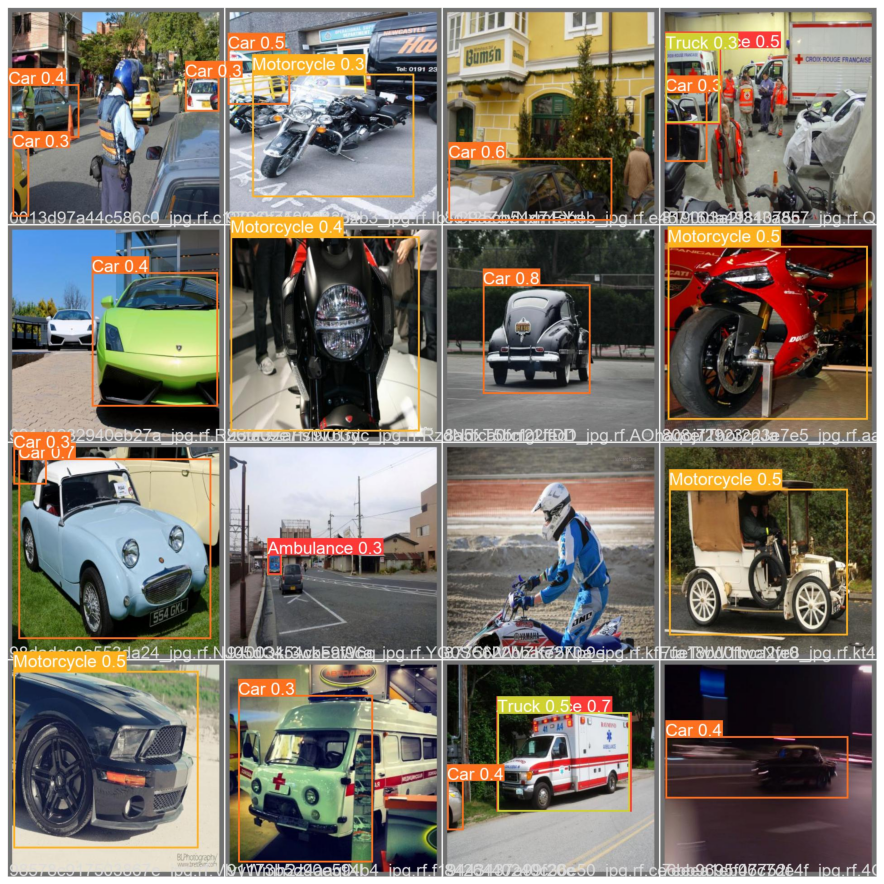

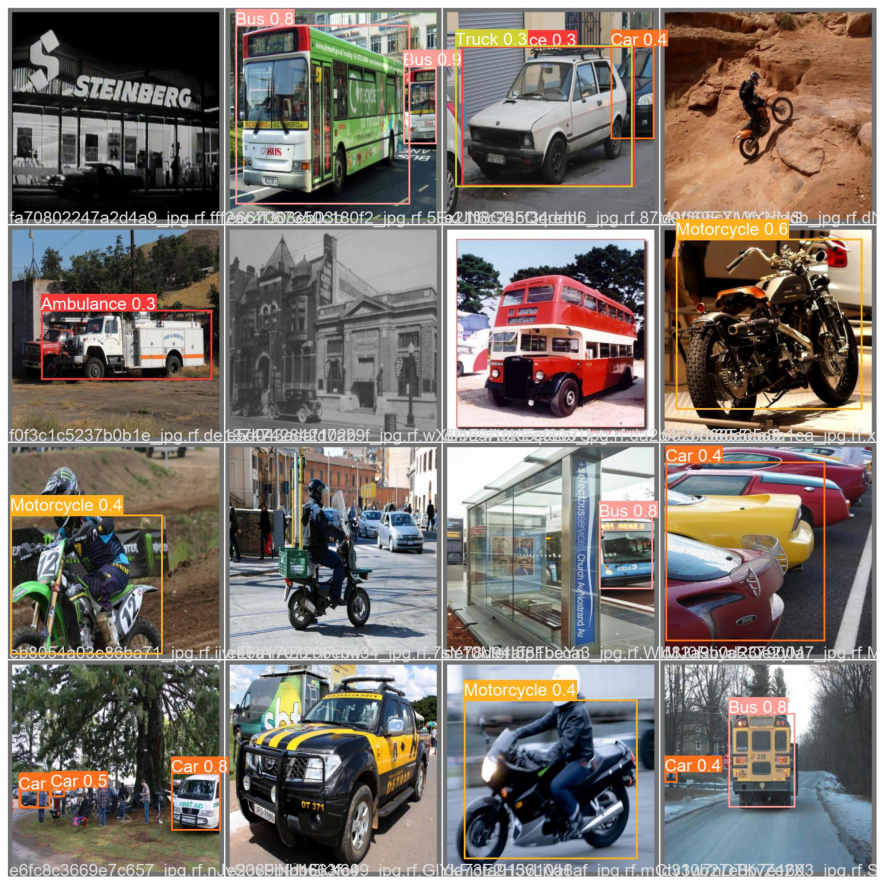

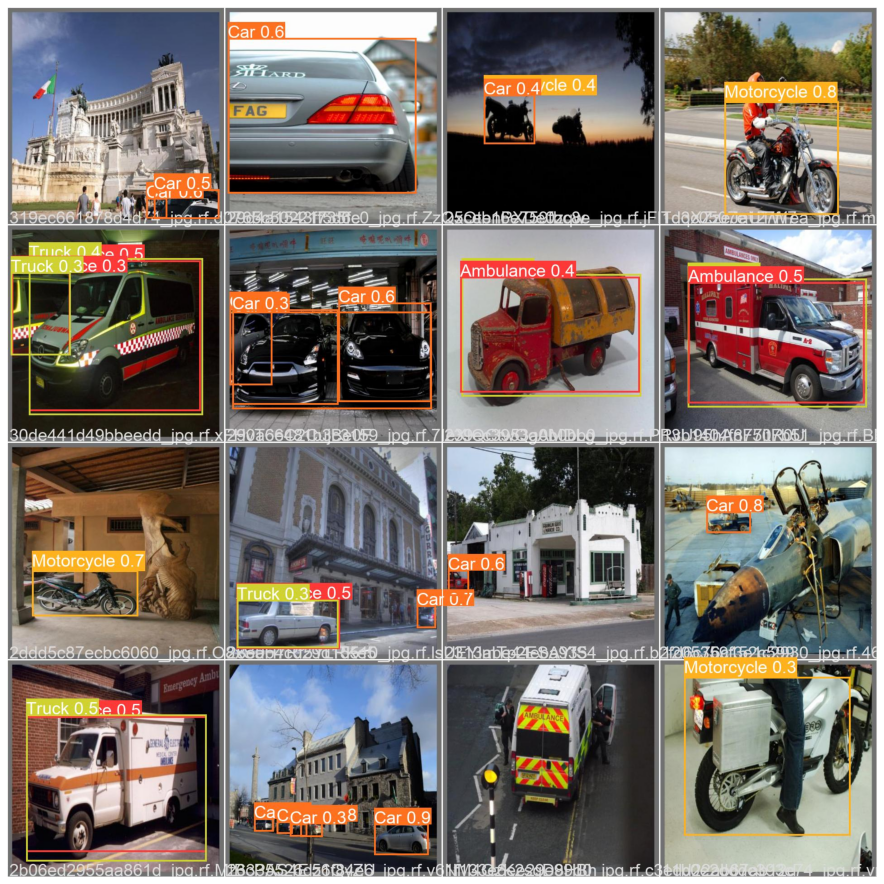

In [30]:
show_valid_results(RES_DIR)

### Inference
In this section, we will carry out inference on unseen images and videos from the internet. 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Let's download the images and videos that we will carry inference upon.

In [38]:
download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
              'inference_data.zip')
# if not os.path.exists('inference_images'):
#     !unzip -q "inference_data.zip"
# else:
#     print('Dataset already present')
    
import zipfile
with zipfile.ZipFile('inference_data.zip', 'r') as zip_ref:
    zip_ref.extractall('inference_images')

File already present, skipping download...


### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [43]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images/inference_images')

Current number of inference detection directories: 2
inference_3


detect: weights=['runs/train/results_8/weights/best.pt'], source=inference_images/inference_images, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
fatal: cannot change to 'D:\IIUM_PC\4.': No such file or directory
YOLOv5  2022-7-7 Python-3.7.9 torch-1.7.1 CUDA:0 (NVIDIA GeForce RTX 2060, 6144MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/4 D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_images\image_1.jpg: 448x640 3 Ambulances, 2 Cars, 5 Trucks, Done. (0.010s)
image 2/4 D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_worksho

['runs/detect/inference_3\\image_1.jpg', 'runs/detect/inference_3\\image_2.jpg', 'runs/detect/inference_3\\image_3.jpg', 'runs/detect/inference_3\\image_4.jpg']


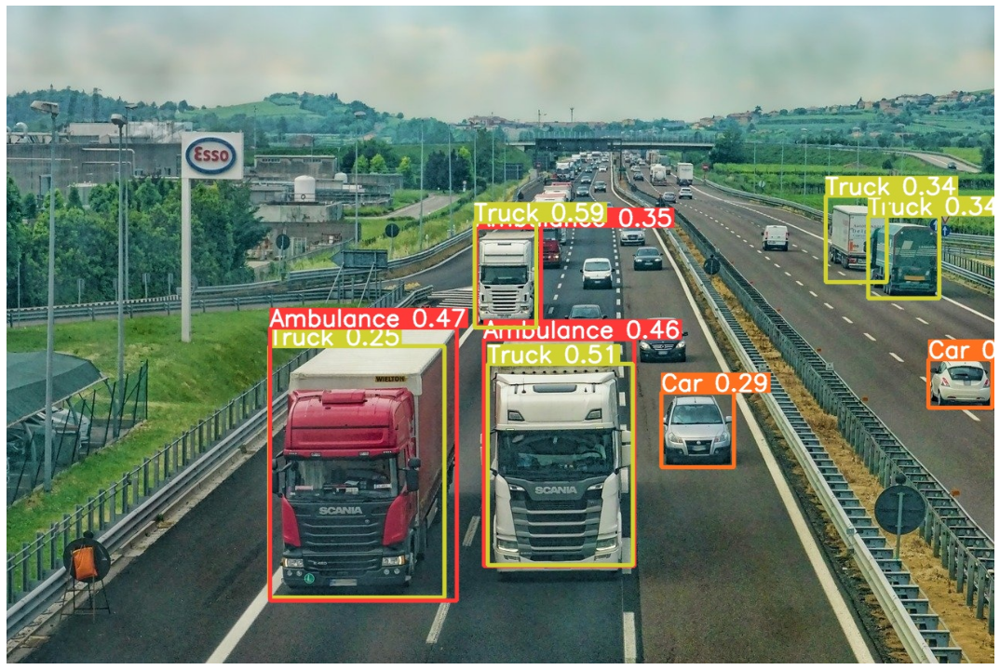

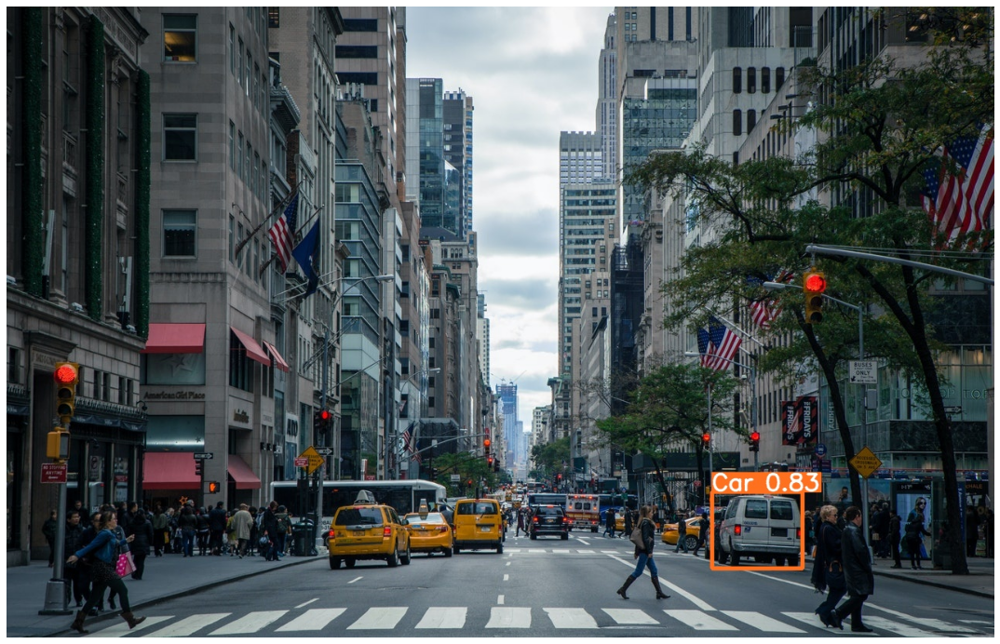

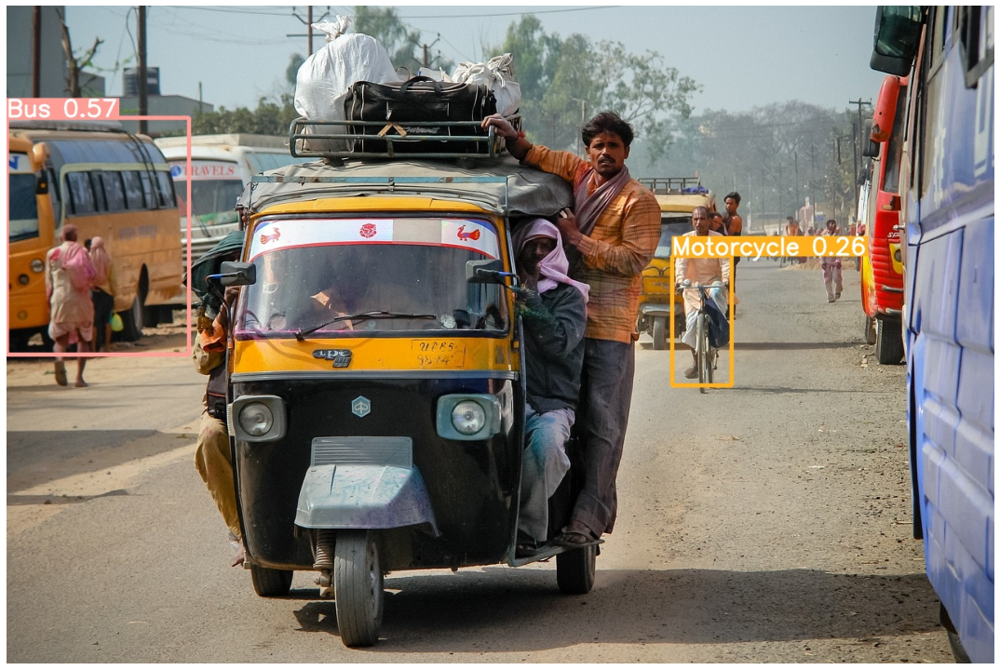

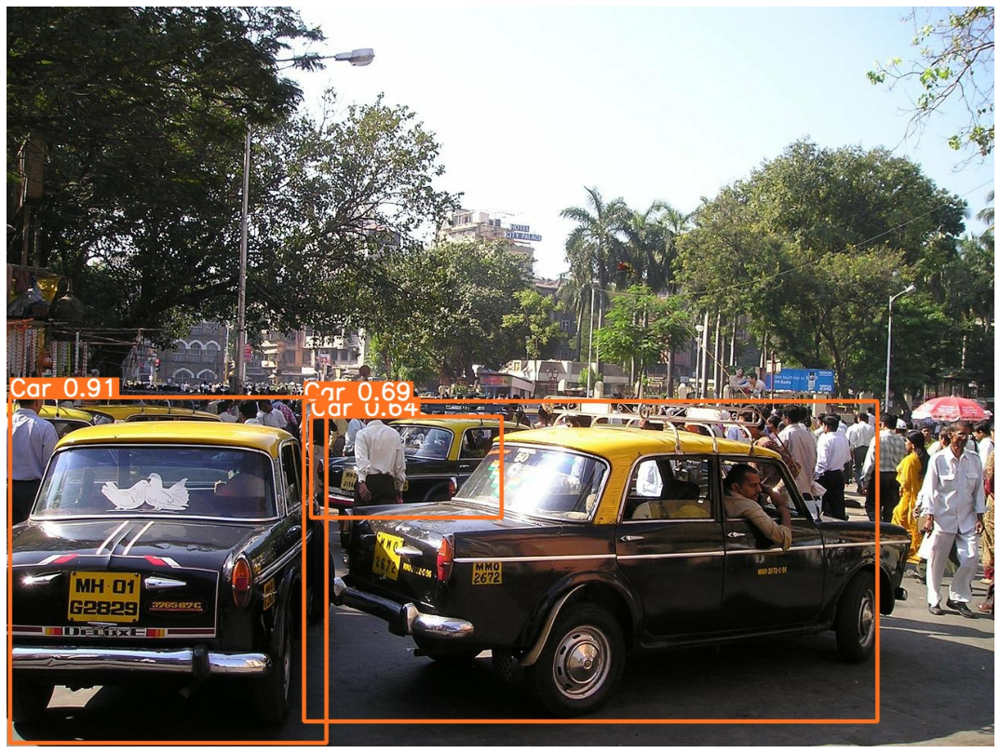

In [44]:
visualize(IMAGE_INFER_DIR)

### Inference on Videos

In [46]:
inference(RES_DIR, 'inference_images/inference_videos')

Current number of inference detection directories: 4
inference_5


detect: weights=['runs/train/results_8/weights/best.pt'], source=inference_images/inference_videos, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
fatal: cannot change to 'D:\IIUM_PC\4.': No such file or directory
YOLOv5  2022-7-7 Python-3.7.9 torch-1.7.1 CUDA:0 (NVIDIA GeForce RTX 2060, 6144MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
video 1/4 (1/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.009s)
video 1/4 (2/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\i

'inference_5'

video 1/4 (29/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, 3 Cars, 1 Motorcycle, Done. (0.008s)
video 1/4 (30/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, 4 Cars, 1 Motorcycle, Done. (0.009s)
video 1/4 (31/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, 2 Cars, 1 Motorcycle, Done. (0.009s)
video 1/4 (32/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, 2 Cars, 1 Motorcycle, Done. (0.009s)
video 1/4 (33/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Ambulance, 1 Bus, 2 Cars, 1 Motorcycle, 1 Truck

video 1/4 (346/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.006s)
video 1/4 (347/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.007s)
video 1/4 (348/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.006s)
video 1/4 (349/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.006s)
video 1/4 (350/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.006s)
video 1/4 (351/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp

## Training and Inference using  Medium Model

In [47]:
monitor_tensorboard()

In [26]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Current number of result directories: 1
results_2
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 27 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=

In [27]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_2/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_images/image_1.jpg: 448x640 2 Ambulances, 1 Car, 4 Trucks, Done. (0.021s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detect

['runs/detect/inference_3/image_1.jpg', 'runs/detect/inference_3/image_4.jpg', 'runs/detect/inference_3/image_2.jpg', 'runs/detect/inference_3/image_3.jpg']


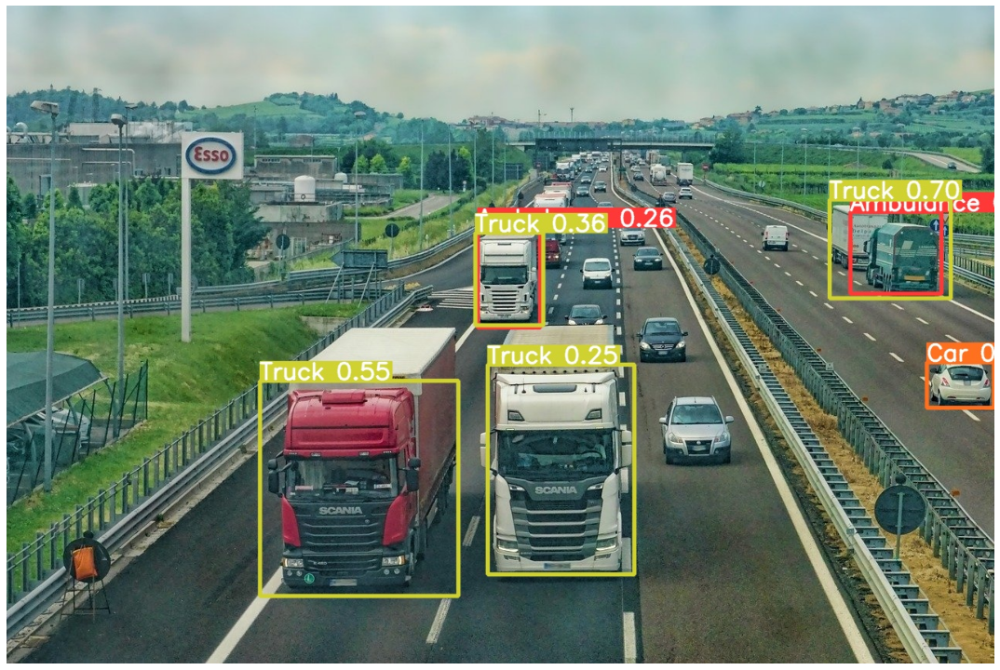

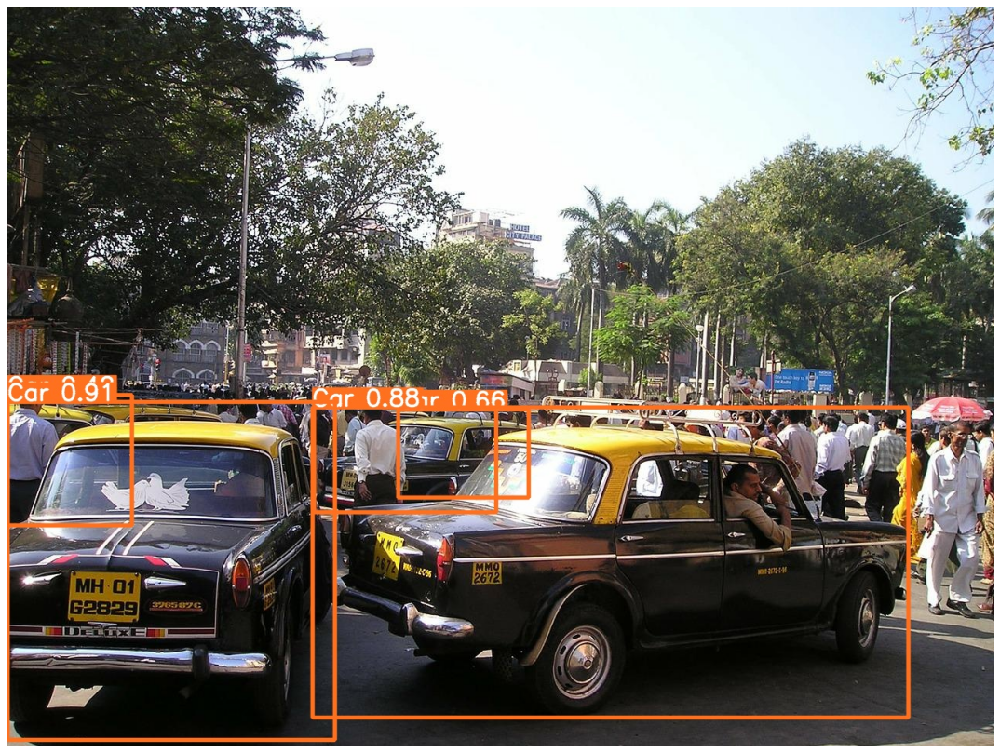

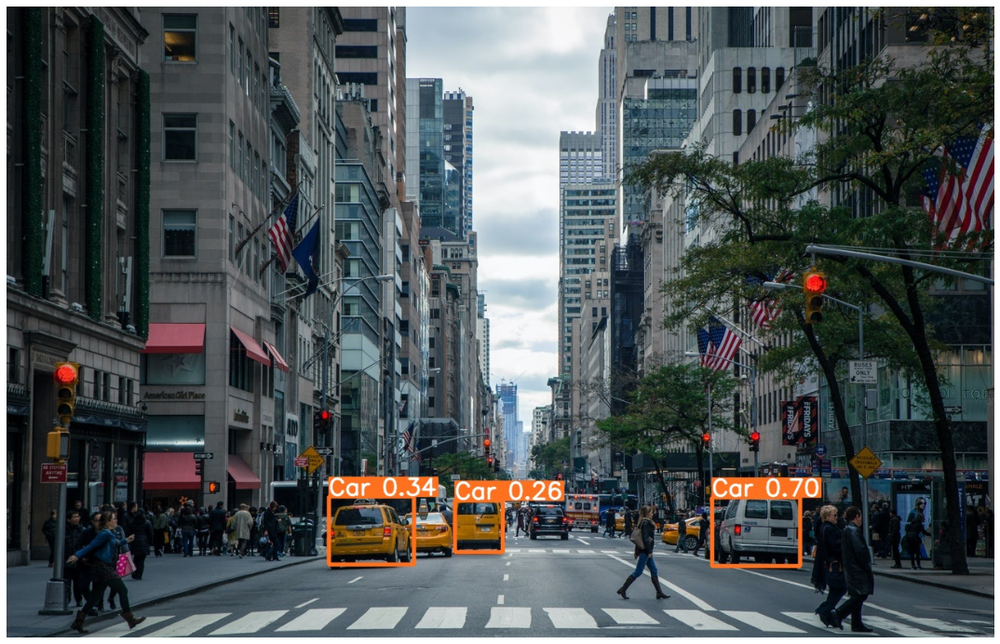

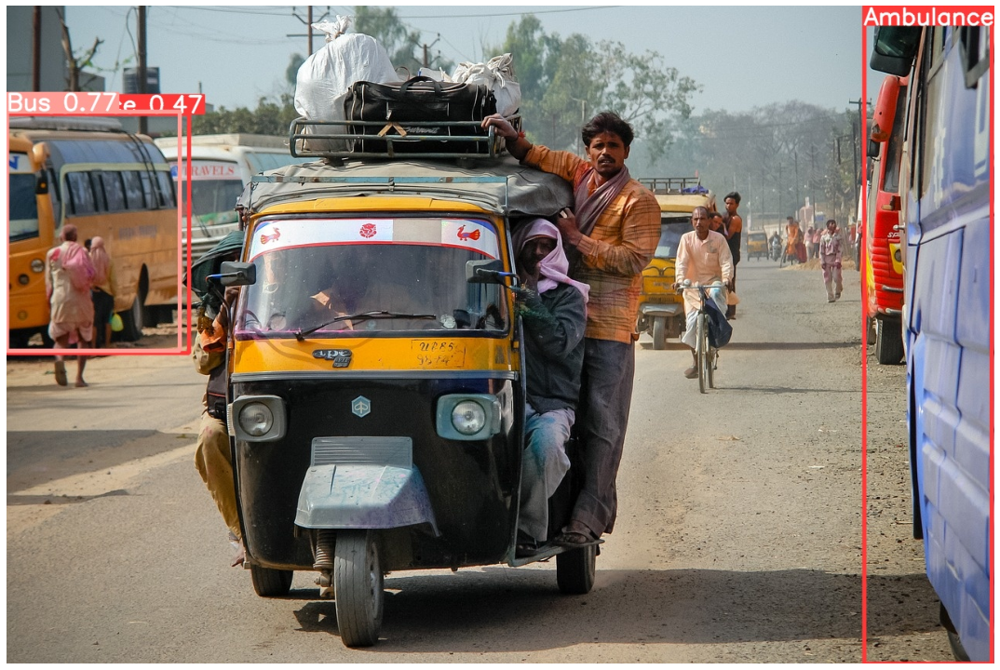

In [28]:
visualize(IMAGE_INFER_DIR)

In [45]:
inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 3
inference_4


detect: weights=['runs/train/results_8/weights/best.pt'], source=inference_videos, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=inference_4, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
fatal: cannot change to 'D:\IIUM_PC\4.': No such file or directory
YOLOv5  2022-7-7 Python-3.7.9 torch-1.7.1 CUDA:0 (NVIDIA GeForce RTX 2060, 6144MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Traceback (most recent call last):
  File "detect.py", line 256, in <module>
    main(opt)
  File "detect.py", line 251, in main
    run(**vars(opt))
  File "C:\Users\hasan\anaconda3\envs\pytorch_hasan\lib\site-packages\torch\autograd\grad_mode.py", line 26, in decorate_context
    ret

'inference_4'

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.

In [30]:
monitor_tensorboard()

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 13752), started 0:47:16 ago. (Use '!kill 13752' to kill it.)

In [31]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} \
    --freeze 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

Current number of result directories: 2
results_3
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=25, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_3, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 27 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_m

albumentations: Blur(always_apply=False, p=0.01, blur_limit=(3, 7)), MedianBlur(always_apply=False, p=0.01, blur_limit=(3, 7)), ToGray(always_apply=False, p=0.01), CLAHE(always_apply=False, p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
train: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_obj
val: Scanning '/home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_objec
Plotting labels to runs/train/results_3/labels.jpg... 

AutoAnchor: 3.85 anchors/target, 1.000 Best Possible Recall (BPR). Current anchors are a good fit to dataset ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/train/results_3
Starting training for 25 epochs...

     Epoch   gpu_mem       box       obj       cls    labels  img_size
      0/24     1.73G    0.1007   0.03514   0.04814        20       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.165       0.

     23/24     2.45G   0.03313   0.02219    0.0164        19       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.642      0.629      0.639      0.447

     Epoch   gpu_mem       box       obj       cls    labels  img_size
     24/24     2.45G   0.03252    0.0219   0.01616        37       640: 100%|███
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227      0.631      0.631      0.637      0.451

25 epochs completed in 0.231 hours.
Optimizer stripped from runs/train/results_3/weights/last.pt, 42.3MB
Optimizer stripped from runs/train/results_3/weights/best.pt, 42.3MB

Validating runs/train/results_3/weights/best.pt...
Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all        125        227  

In [32]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, 'inference_images')

Current number of inference detection directories: 4
inference_5
detect: weights=['runs/train/results_3/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_5, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
image 1/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_images/image_1.jpg: 448x640 3 Buss, 5 Cars, Done. (0.021s)
image 2/4 /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_us

['runs/detect/inference_5/image_1.jpg', 'runs/detect/inference_5/image_4.jpg', 'runs/detect/inference_5/image_2.jpg', 'runs/detect/inference_5/image_3.jpg']


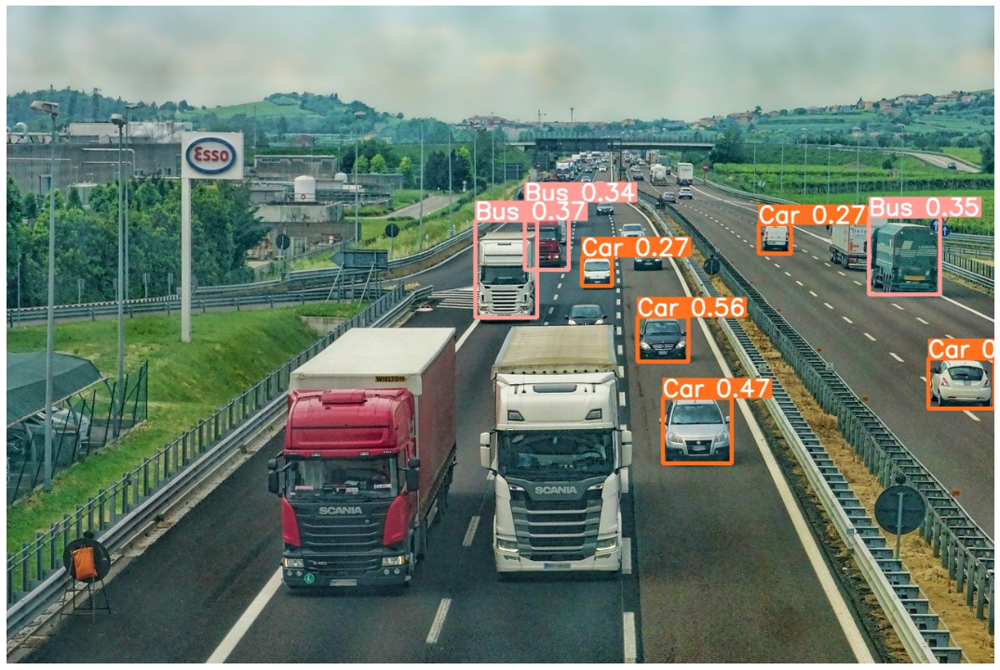

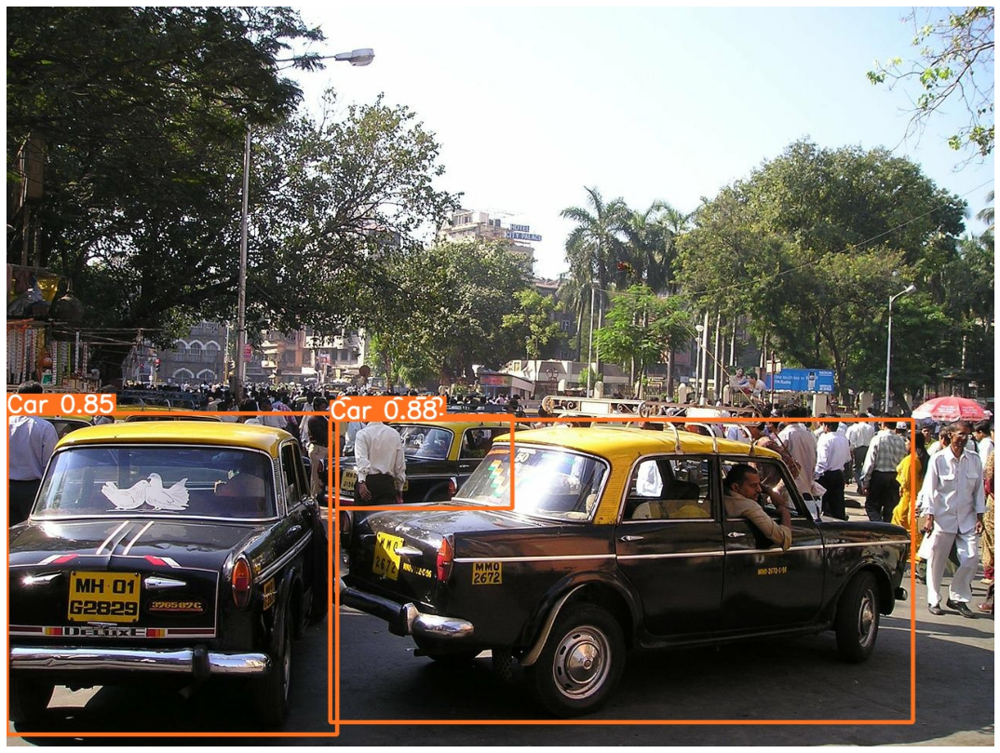

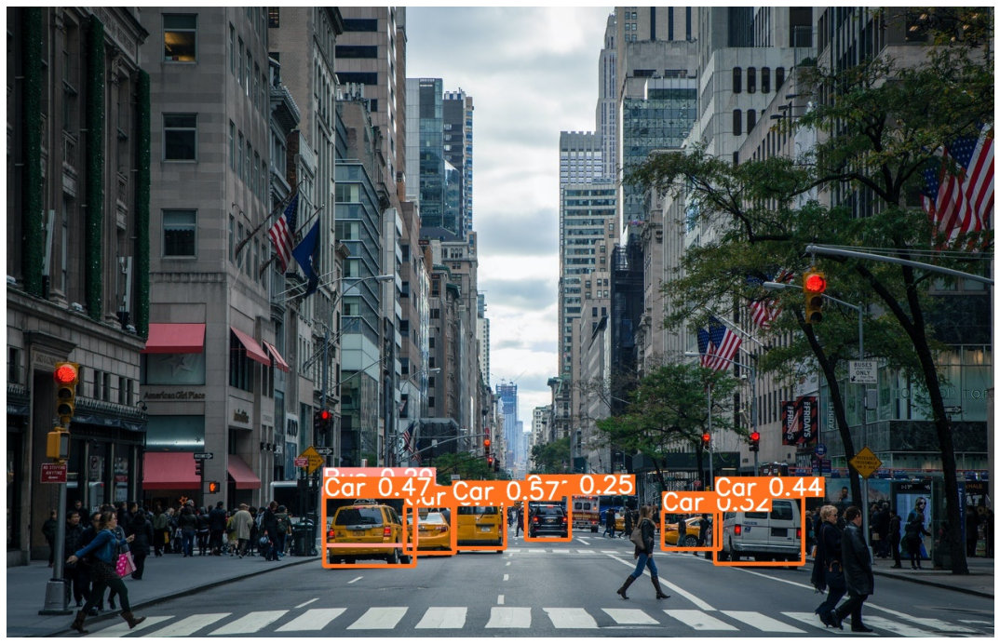

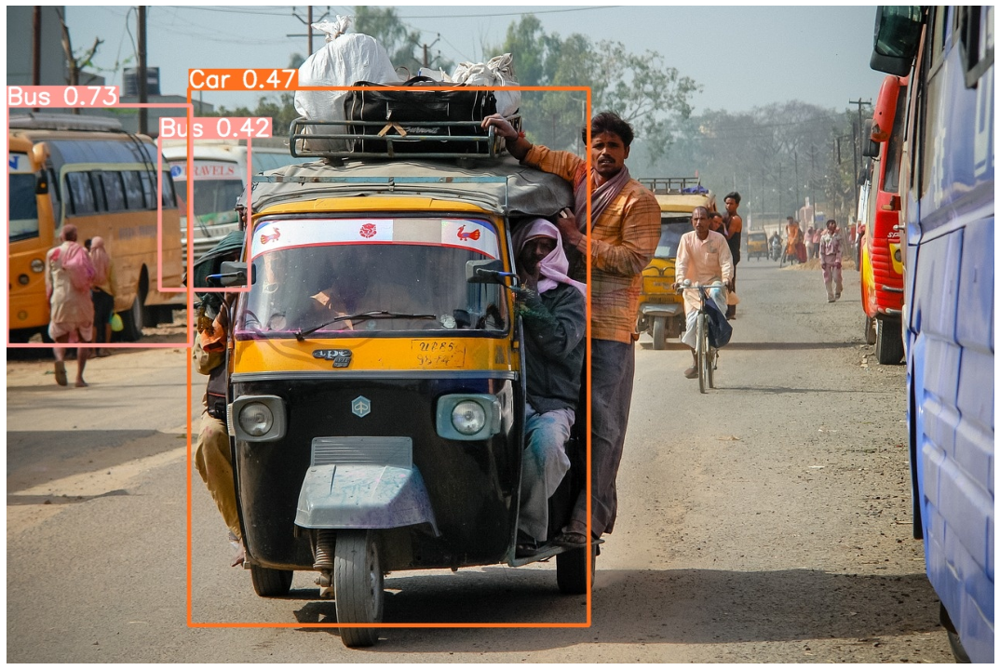

In [33]:
visualize(IMAGE_INFER_DIR)

In [34]:
inference(RES_DIR, 'inference_videos')

Current number of inference detection directories: 5
inference_6
detect: weights=['runs/train/results_3/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_6, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (NVIDIA GeForce GTX 1060, 6078MiB)

Fusing layers... 
Model summary: 290 layers, 20869098 parameters, 0 gradients
video 1/4 (1/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.019s)
video 1/4 (2/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_us

video 1/4 (36/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 1/4 (37/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 4 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 1/4 (38/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 5 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 1/4 (39/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 4 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 1/4 (40/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_o

video 1/4 (76/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, 1 Truck, Done. (0.016s)
video 1/4 (77/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, 1 Truck, Done. (0.016s)
video 1/4 (78/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, 1 Truck, Done. (0.016s)
video 1/4 (79/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 2 Cars, 1 Truck, Done. (0.016s)
video 1/4 (80/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov

video 1/4 (116/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)
video 1/4 (117/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)
video 1/4 (118/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)
video 1/4 (119/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)
video 1/4 (120/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, Done. (0.016s)


video 1/4 (158/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 2 Cars, Done. (0.016s)
video 1/4 (159/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 2 Cars, Done. (0.016s)
video 1/4 (160/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 2 Cars, Done. (0.016s)
video 1/4 (161/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 2 Cars, 1 Truck, Done. (0.016s)
video 1/4 (162/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/vid

video 1/4 (198/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 2 Cars, Done. (0.016s)
video 1/4 (199/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 2 Cars, Done. (0.016s)
video 1/4 (200/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 2 Cars, Done. (0.016s)
video 1/4 (201/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, Done. (0.016s)
video 1/4 (202/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 38

video 1/4 (238/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, Done. (0.016s)
video 1/4 (239/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 2 Buss, 3 Cars, Done. (0.016s)
video 1/4 (240/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 4 Cars, Done. (0.016s)
video 1/4 (241/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 4 Cars, Done. (0.016s)
video 1/4 (242/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 3

video 1/4 (280/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (281/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (282/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (283/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (284/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (285/513) /home/sovit/my_data/

video 1/4 (324/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (325/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (326/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (327/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (328/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (329/513) /home/sovit/my_data/

video 1/4 (367/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (368/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (369/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (370/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (371/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.017s)
video 1/4 (372/513) /home/sovit/my_data/

video 1/4 (411/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (412/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (413/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (414/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (415/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 Done. (0.016s)
video 1/4 (416/513) /home/sovit/my_data/

video 1/4 (454/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (455/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (456/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (457/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 3 Cars, Done. (0.016s)
video 1/4 (458/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)


video 1/4 (495/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (496/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (497/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 4 Cars, Done. (0.016s)
video 1/4 (498/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 1 Bus, 4 Cars, Done. (0.016s)
video 1/4 (499/513) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_1.mp4: 384x640 5 Cars, Done. (0

video 2/4 (22/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (23/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (24/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (25/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (26/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/infere

video 2/4 (61/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 5 Motorcycles, Done. (0.016s)
video 2/4 (62/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 5 Motorcycles, Done. (0.016s)
video 2/4 (63/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (64/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 4 Motorcycles, Done. (0.016s)
video 2/4 (65/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/infere

video 2/4 (101/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (102/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (103/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (104/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (105/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/i

video 2/4 (140/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (141/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (142/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (143/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (144/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/i

video 2/4 (179/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 1 Car, 3 Motorcycles, Done. (0.016s)
video 2/4 (180/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (181/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (182/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (183/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/in

video 2/4 (218/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (219/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 4 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (220/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (221/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (222/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/in

video 2/4 (257/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 2/4 (258/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 2/4 (259/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 2 Cars, 1 Motorcycle, 1 Truck, Done. (0.016s)
video 2/4 (260/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 3 Cars, 2 Motorcycles, 1 Truck, Done. (0.016s)
video 2/4 (261/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_u

video 2/4 (295/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (296/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (297/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (298/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (299/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/i

video 2/4 (334/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (335/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 3 Motorcycles, Done. (0.016s)
video 2/4 (336/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (337/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 12 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (338/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/i

video 2/4 (374/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, Done. (0.016s)
video 2/4 (375/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, Done. (0.015s)
video 2/4 (376/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (377/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (378/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 38

video 2/4 (414/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (415/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (416/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (417/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (418/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/infer

video 2/4 (454/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (455/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 11 Cars, 2 Motorcycles, Done. (0.016s)
video 2/4 (456/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (457/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 9 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (458/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inf

video 2/4 (493/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (494/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (495/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 8 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (496/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 7 Cars, 1 Motorcycle, Done. (0.016s)
video 2/4 (497/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/infer

video 2/4 (533/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.017s)
video 2/4 (534/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.016s)
video 2/4 (535/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.016s)
video 2/4 (536/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.016s)
video 2/4 (537/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.016s)


video 2/4 (574/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, Done. (0.016s)
video 2/4 (575/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, Done. (0.016s)
video 2/4 (576/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, Done. (0.016s)
video 2/4 (577/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 5 Cars, Done. (0.016s)
video 2/4 (578/610) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_2.mp4: 384x640 6 Cars, Done. (0.016s)


video 3/4 (6/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 3 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (7/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 4 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (8/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 4 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (9/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 4 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (10/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPD

video 3/4 (44/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 3 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (45/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 2 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (46/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Buss, 2 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (47/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 4 Buss, 2 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (48/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_y

video 3/4 (81/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 2 Cars, 2 Motorcycles, 1 Truck, Done. (0.016s)
video 3/4 (82/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Cars, 2 Motorcycles, 1 Truck, Done. (0.016s)
video 3/4 (83/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 2 Cars, 2 Motorcycles, 1 Truck, Done. (0.016s)
video 3/4 (84/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 3 Cars, 2 Motorcycles, 1 Truck, Done. (0.016s)
video 3/4 (85/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_train

video 3/4 (118/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 4 Motorcycles, Done. (0.017s)
video 3/4 (119/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 10 Cars, 4 Motorcycles, Done. (0.017s)
video 3/4 (120/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 9 Cars, 4 Motorcycles, Done. (0.017s)
video 3/4 (121/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 7 Cars, 4 Motorcycles, Done. (0.017s)
video 3/4 (122/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5

video 3/4 (155/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 3 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (156/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 3 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (157/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 3 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (158/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 4 Cars, 2 Motorcycles, Done. (0.016s)
video 3/4 (159/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_

video 3/4 (192/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 5 Cars, 2 Motorcycles, Done. (0.017s)
video 3/4 (193/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 5 Cars, 2 Motorcycles, Done. (0.017s)
video 3/4 (194/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 6 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (195/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 7 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (196/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yo

video 3/4 (229/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 7 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (230/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 6 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (231/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 5 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (232/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_3.mp4: 384x640 1 Bus, 5 Cars, 1 Motorcycle, Done. (0.016s)
video 3/4 (233/246) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolo

video 4/4 (21/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, 1 Truck, Done. (0.017s)
video 4/4 (22/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 13 Cars, 1 Truck, Done. (0.016s)
video 4/4 (23/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, Done. (0.016s)
video 4/4 (24/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 12 Cars, Done. (0.016s)
video 4/4 (25/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

video 4/4 (59/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (60/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, Done. (0.016s)
video 4/4 (61/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 16 Cars, Done. (0.016s)
video 4/4 (62/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 17 Cars, Done. (0.016s)
video 4/4 (63/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/vid

video 4/4 (99/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 2 Buss, 15 Cars, Done. (0.016s)
video 4/4 (100/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, Done. (0.016s)
video 4/4 (101/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 2 Buss, 14 Cars, Done. (0.016s)
video 4/4 (102/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 2 Buss, 14 Cars, Done. (0.016s)
video 4/4 (103/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video

video 4/4 (139/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (140/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (141/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (142/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (143/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done.

video 4/4 (179/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, Done. (0.016s)
video 4/4 (180/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, Done. (0.016s)
video 4/4 (181/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (182/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (183/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 

video 4/4 (221/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (222/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (223/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (224/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (225/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done.

video 4/4 (263/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (264/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (265/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (266/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (267/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/v

video 4/4 (304/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 13 Cars, Done. (0.017s)
video 4/4 (305/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 13 Cars, Done. (0.016s)
video 4/4 (306/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, Done. (0.016s)
video 4/4 (307/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, Done. (0.016s)
video 4/4 (308/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4

video 4/4 (345/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 1 Truck, Done. (0.017s)
video 4/4 (346/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (347/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (348/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (349/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Ca

video 4/4 (385/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Ambulance, 11 Cars, Done. (0.016s)
video 4/4 (386/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Ambulance, 13 Cars, Done. (0.016s)
video 4/4 (387/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Ambulance, 14 Cars, Done. (0.016s)
video 4/4 (388/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Ambulance, 13 Cars, Done. (0.016s)
video 4/4 (389/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/

video 4/4 (426/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (427/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (428/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (429/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (430/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done.

video 4/4 (467/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 15 Cars, Done. (0.016s)
video 4/4 (468/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 13 Cars, 1 Truck, Done. (0.016s)
video 4/4 (469/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (470/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (471/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolo

video 4/4 (508/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (509/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (510/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (511/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (512/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done.

video 4/4 (550/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 1 Truck, Done. (0.016s)
video 4/4 (551/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 11 Cars, 1 Truck, Done. (0.016s)
video 4/4 (552/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Bus, 11 Cars, 1 Truck, Done. (0.016s)
video 4/4 (553/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, 1 Truck, Done. (0.016s)
video 4/4 (554/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/in

video 4/4 (591/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done. (0.016s)
video 4/4 (592/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done. (0.016s)
video 4/4 (593/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done. (0.016s)
video 4/4 (594/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done. (0.016s)
video 4/4 (595/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, Done.

video 4/4 (632/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, 1 Truck, Done. (0.016s)
video 4/4 (633/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, Done. (0.016s)
video 4/4 (634/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, Done. (0.016s)
video 4/4 (635/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, Done. (0.016s)
video 4/4 (636/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars,

video 4/4 (674/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, Done. (0.016s)
video 4/4 (675/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, Done. (0.016s)
video 4/4 (676/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, Done. (0.016s)
video 4/4 (677/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 9 Cars, Done. (0.016s)
video 4/4 (678/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, Done. (

video 4/4 (715/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (716/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (717/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (718/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (719/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done.

video 4/4 (756/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.017s)
video 4/4 (757/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (758/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 11 Cars, Done. (0.017s)
video 4/4 (759/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (760/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done.

video 4/4 (798/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (799/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (800/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.016s)
video 4/4 (801/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.017s)
video 4/4 (802/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done.

video 4/4 (840/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (841/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (842/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (843/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done. (0.017s)
video 4/4 (844/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, Done.

video 4/4 (882/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, Done. (0.016s)
video 4/4 (883/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, Done. (0.016s)
video 4/4 (884/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, Done. (0.016s)
video 4/4 (885/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, Done. (0.016s)
video 4/4 (886/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 19 Cars, Done.

video 4/4 (923/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (924/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (925/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (926/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.016s)
video 4/4 (927/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done.

video 4/4 (964/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (965/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (966/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (967/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (968/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done.

video 4/4 (1006/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (1007/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (1008/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, Done. (0.016s)
video 4/4 (1009/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, Done. (0.016s)
video 4/4 (1010/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 

video 4/4 (1047/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (1048/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.016s)
video 4/4 (1049/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, Done. (0.017s)
video 4/4 (1050/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, Done. (0.017s)
video 4/4 (1051/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 

video 4/4 (1089/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.017s)
video 4/4 (1090/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.017s)
video 4/4 (1091/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.017s)
video 4/4 (1092/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.017s)
video 4/4 (1093/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 

video 4/4 (1131/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, Done. (0.017s)
video 4/4 (1132/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, Done. (0.017s)
video 4/4 (1133/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.017s)
video 4/4 (1134/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, Done. (0.016s)
video 4/4 (1135/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 

video 4/4 (1172/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (1173/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (1174/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, Done. (0.016s)
video 4/4 (1175/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, Done. (0.016s)
video 4/4 (1176/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 

video 4/4 (1213/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1214/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1215/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1216/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1217/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

video 4/4 (1252/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1253/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1254/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1255/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 1 Ambulance, 14 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1256/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov

video 4/4 (1290/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 12 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1291/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1292/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 13 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1293/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 10 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1294/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

video 4/4 (1329/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1330/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1331/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1332/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1333/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

video 4/4 (1368/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1369/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1370/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1371/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 15 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1372/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

video 4/4 (1407/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (1408/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1409/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1410/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.017s)
video 4/4 (1411/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_

video 4/4 (1447/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (1448/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (1449/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (1450/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 18 Cars, 2 Trucks, Done. (0.016s)
video 4/4 (1451/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inferen

video 4/4 (1488/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1489/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1490/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 16 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1491/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_videos/video_4.mp4: 384x640 17 Cars, 1 Truck, Done. (0.016s)
video 4/4 (1492/1501) /home/sovit/my_data/Data_Science/Big_Vision/my_blogs/custom_object_detection_training_using_yolov5/UPDATED_code/yolov5/inference_v

'inference_6'

In [51]:
!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source inference_images/inference_videos/video_1.mp4

detect: weights=['runs/train/results_8/weights/best.pt'], source=inference_images/inference_videos/video_1.mp4, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
fatal: cannot change to 'D:\IIUM_PC\4.': No such file or directory
YOLOv5  2022-7-7 Python-3.7.9 torch-1.7.1 CUDA:0 (NVIDIA GeForce RTX 2060, 6144MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 Done. (0.009s)
video 1/1 (2/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolo

video 1/1 (116/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, Done. (0.009s)
video 1/1 (117/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, Done. (0.009s)
video 1/1 (118/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, Done. (0.010s)
video 1/1 (119/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 1 Bus, Done. (0.009s)
video 1/1 (120/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inference_images\inference_videos\video_1.mp4: 384x640 2 Buss, Done. (0.009s)
video 1/1 (121/513) D:\IIUM_PC\4. TALK-WORKSHOP_TRAINING\3-week workshop DL\DL_workshop_codes\yolov5\inferenc